In [1]:
import yfinance as yf 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


/Users/zaina/Desktop/github/financial-bot/dataprepenv/lib/python3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


In [4]:
# !pip3 freeze > /Users/zaina/Downloads/assignment/requirements.txt
# !python3 -m venv /Users/zaina/Downloads/assignment/py3.9.6

In [2]:
assets = ["BTC-USD"]

In [3]:
df = yf.download(assets)

print('head \n',df.head())
print('tail\n',df.tail())


[*********************100%%**********************]  1 of 1 completed

head 
                   Open        High         Low       Close   Adj Close  \
Date                                                                     
2014-09-17  465.864014  468.174011  452.421997  457.334015  457.334015   
2014-09-18  456.859985  456.859985  413.104004  424.440002  424.440002   
2014-09-19  424.102997  427.834991  384.532013  394.795990  394.795990   
2014-09-20  394.673004  423.295990  389.882996  408.903992  408.903992   
2014-09-21  408.084991  412.425995  393.181000  398.821014  398.821014   

              Volume  
Date                  
2014-09-17  21056800  
2014-09-18  34483200  
2014-09-19  37919700  
2014-09-20  36863600  
2014-09-21  26580100  
tail
                     Open          High           Low         Close  \
Date                                                                 
2024-06-13  68243.101562  68365.781250  66304.562500  66756.398438   
2024-06-14  66747.570312  67294.648438  65056.894531  66011.093750   
2024-06-15  66006.742188  6

In [78]:
prices = df['Adj Close']

In [79]:
returns = prices.pct_change()


returns.fillna(0, inplace=True)


print(returns.head())
print(returns.tail())


Date
2020-08-01    0.0
2020-08-02    0.0
2020-08-03    0.0
2020-08-04    0.0
2020-08-05    0.0
Name: Adj Close, dtype: float64
Date
2024-06-10    0.000000
2024-06-11   -0.043478
2024-06-12    0.000000
2024-06-13   -0.045455
2024-06-14    0.027629
Name: Adj Close, dtype: float64


In [81]:
cum_ret = (returns + 1).cumprod() - 1

# Display the last few rows of cumulative returns
print(cum_ret.tail())

Date
2024-06-10    inf
2024-06-11    inf
2024-06-12    inf
2024-06-13    inf
2024-06-14    inf
Name: Adj Close, dtype: float64


<Axes: xlabel='Date'>

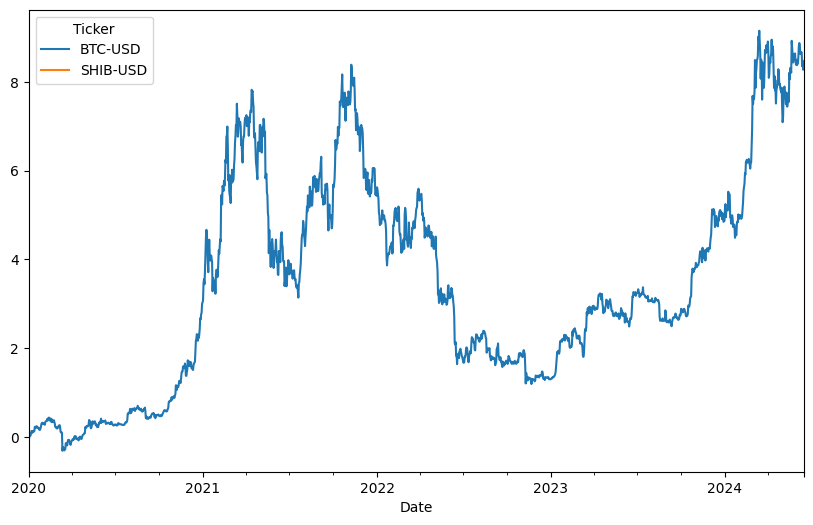

In [38]:
cum_ret.plot(figsize=(10,6) )

In [24]:
import yfinance as yf
import pandas as pd
from datetime import datetime, timedelta

def get_ticker_data(ticker_symbol, days_from_today=30, interval='1d'):
    # Calculate the start date
    end_date = datetime.now()
    start_date = end_date - timedelta(days=days_from_today)
    
    # Fetching the cryptocurrency data
    crypto = yf.Ticker(ticker_symbol)
    data = crypto.history(start=start_date.strftime('%Y-%m-%d'), end=end_date.strftime('%Y-%m-%d'), interval=interval)
    
    # Check if data is available
    if not data.empty:
        return data
    else:
        return "No data found for the specified cryptocurrency."


In [25]:

# User-defined parameters
ticker_symbol = "^GSPC"        # Example cryptocurrency ticker
days_from_today = 10000         # Number of days from today
interval = "1d"                  # Data interval ('1m', '2m', '5m', '15m', '30m', '60m', '90m', '1h', '1d', '5d', '1wk', '1mo', '3mo')

# Fetch the data and save to CSV
data = get_ticker_data(ticker_symbol, days_from_today, interval)
print('len: ', len(data))
display(data)



len:  6889


,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
1997-01-30 00:00:00-05:00,772.500000,784.169983,772.500000,784.169983,524160000,0.0,0.0
1997-01-31 00:00:00-05:00,784.169983,791.859985,784.169983,786.159973,578550000,0.0,0.0
1997-02-03 00:00:00-05:00,786.159973,787.140015,783.119995,786.729980,463600000,0.0,0.0
1997-02-04 00:00:00-05:00,786.729980,789.280029,783.679993,789.260010,506530000,0.0,0.0
1997-02-05 00:00:00-05:00,789.260010,792.710022,773.429993,778.280029,580520000,0.0,0.0
...,...,...,...,...,...,...,...
2024-06-10 00:00:00-04:00,5341.220215,5365.790039,5331.520020,5360.790039,3622280000,0.0,0.0
2024-06-11 00:00:00-04:00,5353.000000,5375.950195,5327.250000,5375.319824,3568030000,0.0,0.0
2024-06-12 00:00:00-04:00,5409.129883,5447.250000,5409.129883,5421.029785,3962840000,0.0,0.0


In [26]:
data_full= data.copy()
# data_full.drop(columns = ['Dividends', 'Stock Splits'], inplace=True)
data_full["returns"] = data_full['Close'].pct_change()
data_full["cum_returns"]= (data_full["returns"] + 1).cumprod() - 1
data_full= data_full[1:]
data_full['wkDay'] = data_full.index.day_name()
data_full = pd.get_dummies(data_full, columns=['wkDay'])
data_full['Year'] = data_full.index.year
data_full['Month'] = data_full.index.month
data_full['Day'] = data_full.index.day
data_full['Hour'] = data_full.index.hour


In [38]:
print("data_full.info()\n")
display(data_full.info())
print("data_full.head()\n")
display(data_full.head())

data_full.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 6888 entries, 1997-01-31 00:00:00-05:00 to 2024-06-14 00:00:00-04:00
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Open             6888 non-null   float64
 1   High             6888 non-null   float64
 2   Low              6888 non-null   float64
 3   Close            6888 non-null   float64
 4   Volume           6888 non-null   int64  
 5   Dividends        6888 non-null   float64
 6   Stock Splits     6888 non-null   float64
 7   returns          6888 non-null   float64
 8   cum_returns      6888 non-null   float64
 9   wkDay_Friday     6888 non-null   uint8  
 10  wkDay_Monday     6888 non-null   uint8  
 11  wkDay_Thursday   6888 non-null   uint8  
 12  wkDay_Tuesday    6888 non-null   uint8  
 13  wkDay_Wednesday  6888 non-null   uint8  
 14  Year             6888 non-null   int64  
 15  Month            6888 non-null   int64  

None

data_full.head()



,Open,High,Low,Close,Volume,Dividends,Stock Splits,returns,cum_returns,wkDay_Friday,wkDay_Monday,wkDay_Thursday,wkDay_Tuesday,wkDay_Wednesday,Year,Month,Day,Hour
Date,,,,,,,,,,,,,,,,,,
1997-01-31 00:00:00-05:00,784.169983,791.859985,784.169983,786.159973,578550000,0.0,0.0,0.002538,0.002538,1,0,0,0,0,1997,1,31,0
1997-02-03 00:00:00-05:00,786.159973,787.140015,783.119995,786.729980,463600000,0.0,0.0,0.000725,0.003265,0,1,0,0,0,1997,2,3,0
1997-02-04 00:00:00-05:00,786.729980,789.280029,783.679993,789.260010,506530000,0.0,0.0,0.003216,0.006491,0,0,0,1,0,1997,2,4,0
1997-02-05 00:00:00-05:00,789.260010,792.710022,773.429993,778.280029,580520000,0.0,0.0,-0.013912,-0.007511,0,0,0,0,1,1997,2,5,0
1997-02-06 00:00:00-05:00,778.280029,780.349976,774.450012,780.150024,519660000,0.0,0.0,0.002403,-0.005126,0,0,1,0,0,1997,2,6,0


In [39]:
pip install seaborn

  Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)
You should consider upgrading via the '/Users/zaina/Desktop/github/financial-bot/dataprepenv/bin/python -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


  0%|          | 0/2708 [00:00<?, ?it/s]

Report has been saved to SPY Report.html!


DataPrep Report
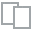
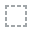
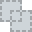
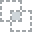
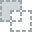
...
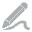
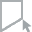
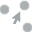
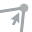
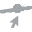

In [27]:
from dataprep.eda import create_report

report = create_report(data_full)

report.save('SPY Report')

report

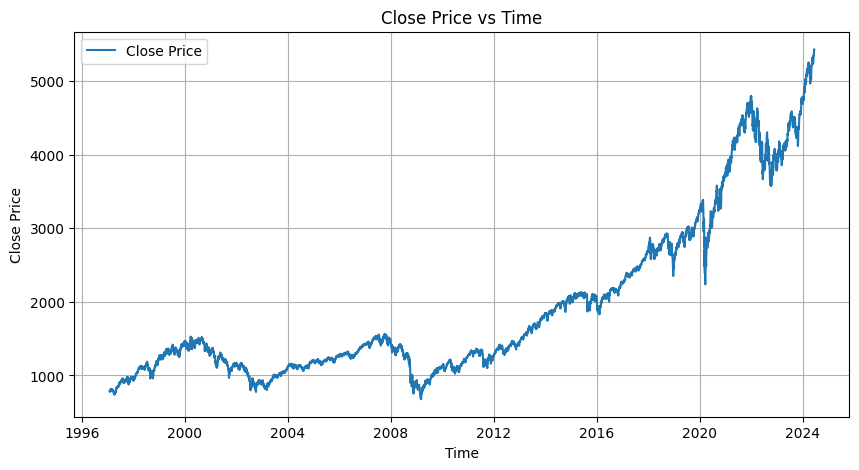

In [28]:
plt.figure(figsize=(10, 5))
plt.plot(data_full.index, data_full['Close'], label='Close Price')
plt.xlabel('Time')
plt.ylabel('Close Price')
plt.title('Close Price vs Time')
plt.legend()
plt.grid(True)
plt.show()

                            OLS Regression Results                            
Dep. Variable:                  Close   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.925e+07
Date:                Mon, 17 Jun 2024   Prob (F-statistic):               0.00
Time:                        12:44:36   Log-Likelihood:                -24529.
No. Observations:                6888   AIC:                         4.907e+04
Df Residuals:                    6883   BIC:                         4.910e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1102      0.243     -0.453      0.6

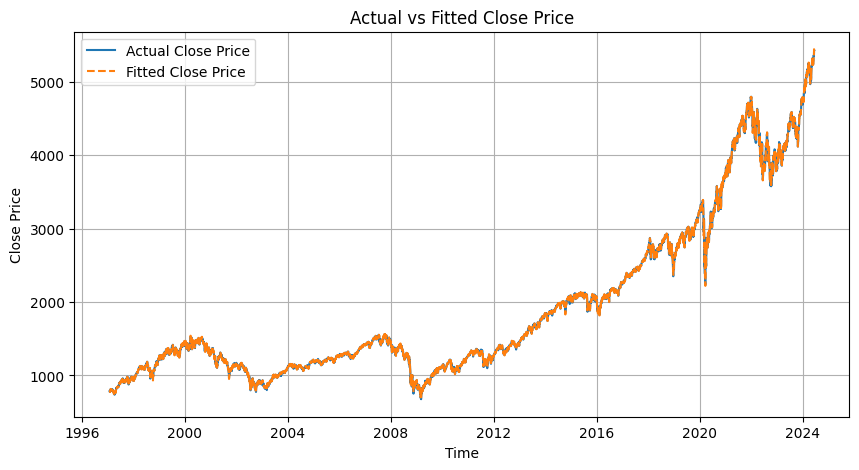

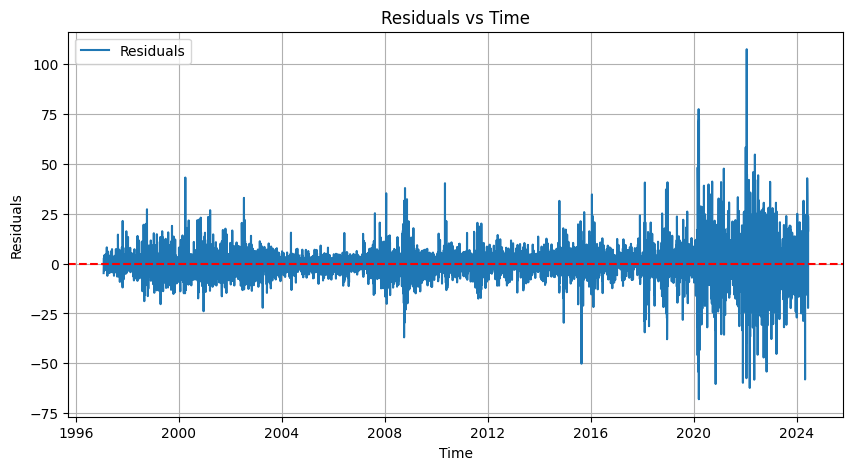

In [37]:
import matplotlib.pyplot as plt
import statsmodels.api as sm
import numpy as np
import pandas as pd

# Assuming 'data_full' is your DataFrame and it has been loaded

# Prepare the data for regression
# Example: let's say we are regressing 'Close' on 'Open', 'High', 'Low', 'Volume'
X = data_full[['Open', 'High', 'Low', 'Volume']]
y = data_full['Close']

# Add a constant to the model (intercept)
X = sm.add_constant(X)

# Fit the regression model
model = sm.OLS(y, X).fit()

# Print the summary of the regression
print(model.summary())

# Perform the Durbin-Watson test
from statsmodels.stats.stattools import durbin_watson

# Get the residuals from the regression model
residuals = model.resid

# Calculate the Durbin-Watson statistic
dw_statistic = durbin_watson(residuals)
print('Durbin-Watson statistic:', dw_statistic)

# Plotting the fitted values vs actual values
plt.figure(figsize=(10, 5))
plt.plot(data_full.index, y, label='Actual Close Price')
plt.plot(data_full.index, model.fittedvalues, label='Fitted Close Price', linestyle='--')
plt.xlabel('Time')
plt.ylabel('Close Price')
plt.title('Actual vs Fitted Close Price')
plt.legend()
plt.grid(True)
plt.show()

# Plotting the residuals
plt.figure(figsize=(10, 5))
plt.plot(data_full.index, residuals, label='Residuals')
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Time')
plt.ylabel('Residuals')
plt.title('Residuals vs Time')
plt.legend()
plt.grid(True)
plt.show()

In [15]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

In [16]:
def make_and_predict(data_full):
    # Normalizing the features
    scaler = MinMaxScaler()
    scaled_features = scaler.fit_transform(data_full.drop(columns=['Close']))

    # Scaling only the 'Close' column
    close_scaler = MinMaxScaler()
    data_full['Close_scaled'] = close_scaler.fit_transform(data_full[['Close']])

    # Splitting into train and test
    split_date = '2023-01-01'  # Modify as per your requirement
    train = data_full[:split_date]
    test = data_full[split_date:]

    X_train = train.drop(columns=['Close', 'Close_scaled'])  # Features
    y_train = train['Close_scaled']  # Scaled target
    X_test = test.drop(columns=['Close', 'Close_scaled'])
    y_test = test['Close_scaled']  # Scaled target



    # Reshaping for LSTM [samples, timesteps, features]
    X_train_lstm = X_train.values.reshape((X_train.shape[0], 1, X_train.shape[1]))
    X_test_lstm = X_test.values.reshape((X_test.shape[0], 1, X_test.shape[1]))

    # Building the model
    model = Sequential()
    model.add(LSTM(50, activation='relu', input_shape=(1, X_train.shape[1])))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mse')

    # Training the model
    model.fit(X_train_lstm, y_train, epochs=100, verbose=1)


    # Predictions
    y_pred_scaled = model.predict(X_test_lstm)

    # Rescale the predictions
    y_pred = close_scaler.inverse_transform(y_pred_scaled)

    # Rescale the actual target values
    y_test_rescaled = close_scaler.inverse_transform(y_test.values.reshape(-1, 1))

    # Performance metrics
    mse = mean_squared_error(y_test_rescaled, y_pred)
    r2 = r2_score(y_test_rescaled, y_pred)

    print(f'Mean Squared Error: {mse}')
    print(f'R^2 Score: {r2}')

    return {
        'model': model,
        'predictions': y_pred,
        'true_values': y_test_rescaled,
        'mse': mse,
        'r2': r2
    }

    
results_full = make_and_predict(data_full)

Epoch 1/100


/Users/zaina/Desktop/github/financial-bot/dataprepenv/lib/python3.9/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


204/204 ━━━━━━━━━━━━━━━━━━━━ 1s 603us/step - loss: 909032579661824.0000 
Epoch 2/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 481us/step - loss: 436915.3125
Epoch 3/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 540us/step - loss: 524.1494
Epoch 4/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 503us/step - loss: 533.7792
Epoch 5/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 544.7112
Epoch 6/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 556.3762
Epoch 7/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 524.9875
Epoch 8/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 615us/step - loss: 551.1917
Epoch 9/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 570us/step - loss: 521.9367
Epoch 10/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 535.0767
Epoch 11/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 483us/step - loss: 538.7845
Epoch 12/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step - loss: 544.5066
Epoch 13/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 524.5580
Epoch 14/100
204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step 

In [30]:
print(f'Mean Squared Error: {results_full["mse"]}')
print(f'R^2 Score: {results_full["r2"]}')

Mean Squared Error: 1.0825296886541441e+18
R^2 Score: -4172031905.1373696


In [ ]:
def compare_results(results_full, results_reduced):
    if results_full and results_reduced:
        # Create a DataFrame for comparison
        comparison_df = pd.DataFrame({
            'Metric': ['Mean Squared Error', 'R^2 Score'],
            'Full Data': [results_full['mse'], results_full['r2']],
            'Reduced Data': [results_reduced['mse'], results_reduced['r2']]
        })

        # Print the comparison table
        print("\nComparison of Results:")
        print("----------------------")
        print(comparison_df.to_string(index=False))
    else:
        print("One of the result sets is None. Check the function for errors.")

# Compare the results
compare_results(results_full, results_reduced)



Comparison of Results:
----------------------
            Metric     Full Data  Reduced Data
Mean Squared Error  1.366753e+16  1.318591e+18
         R^2 Score -5.267417e+07 -5.081802e+09


Testing

In [31]:

scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(data_full.drop(columns=['Close']))

# Scaling only the 'Close' column
close_scaler = MinMaxScaler()
data_full['Close_scaled'] = close_scaler.fit_transform(data_full[['Close']])


In [34]:
def create_sequences(data, look_back=100):
    X, y = [], []
    for i in range(len(data) - look_back):
        X.append(data[i:(i + look_back)])
        y.append(data[i + look_back])
    return np.array(X), np.array(y)

In [45]:

# Splitting into train and test
split_date = '2023-01-01'  # Modify as per your requirement
train = data_full[:split_date]
test = data_full[split_date:]


# Use the scaled 'Close' column to create sequences
look_back = 10

# Create sequences for training
X_train_sequences, y_train_sequences = create_sequences(train['Close_scaled'].values, look_back)
# Create sequences for testing
X_test_sequences, y_test_sequences = create_sequences(test['Close_scaled'].values, look_back)

# Reshape for LSTM [samples, timesteps, features]
X_train_lstm = X_train_sequences.reshape((X_train_sequences.shape[0], look_back, 1))
X_test_lstm = X_test_sequences.reshape((X_test_sequences.shape[0], look_back, 1))

# Building the model
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(look_back, 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Training the model
model.fit(X_train_lstm, y_train_sequences, epochs=10, verbose=0)

# Evaluate the model
loss = model.evaluate(X_test_lstm, y_test_sequences, verbose=0)
print(f"Test Loss: {loss}")

# Predict using the model
predictions = model.predict(X_test_lstm)

Test Loss: 0.00039907664177007973
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [47]:
def testing_different_lookback(look_back):
    # Splitting into train and test
    split_date = '2023-01-01'  # Modify as per your requirement
    train = data_full[:split_date]
    test = data_full[split_date:]

    # Create sequences for training
    X_train_sequences, y_train_sequences = create_sequences(train['Close_scaled'].values, look_back)
    # Create sequences for testing
    X_test_sequences, y_test_sequences = create_sequences(test['Close_scaled'].values, look_back)

    # Reshape for LSTM [samples, timesteps, features]
    X_train_lstm = X_train_sequences.reshape((X_train_sequences.shape[0], look_back, 1))
    X_test_lstm = X_test_sequences.reshape((X_test_sequences.shape[0], look_back, 1))

    # Building the model
    model = Sequential()
    model.add(LSTM(50, activation='relu', input_shape=(look_back, 1)))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mse')

    # Training the model
    model.fit(X_train_lstm, y_train_sequences, epochs=10, verbose=0)

    # Evaluate the model
    loss = model.evaluate(X_test_lstm, y_test_sequences, verbose=0)
    print(f"Test Loss: {loss}")

    # Predict using the model
    predictions = model.predict(X_test_lstm)

    return loss


/Users/zaina/Desktop/github/financial-bot/dataprepenv/lib/python3.9/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Test Loss: 0.0007328136707656085
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


0.0007328136707656085

In [52]:
# Define look-back values to test
look_back_values = [512, 258, 128, 64, 32, 16, 8, 4, 2, 1]

# Store the results
losses = []

for lb in look_back_values:
    loss = testing_different_lookback(lb)
    losses.append(loss)


/Users/zaina/Desktop/github/financial-bot/dataprepenv/lib/python3.9/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Test Loss: 0.0009090040111914277
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
Test Loss: 0.0006905905902385712
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
Test Loss: 0.000594121462199837
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Test Loss: 0.000581781379878521
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Test Loss: 0.0005983498995192349
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Test Loss: 0.0005677847657352686
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.0009304083650931716
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.00037735680234618485
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.0002942859719041735
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.0011648648651316762
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [74]:
import matplotlib.pyplot as plt

def plot_lookback_results(look_back_values):

    # Store the results
    losses = []

    for lb in look_back_values:
        print('lb value: ', lb)
        loss = testing_different_lookback(lb)
        losses.append(loss)

    plt.figure(figsize=(15, 6))
    plt.plot(look_back_values, losses)

    # Add value labels for each point
    for lb, loss in zip(look_back_values, losses):
        plt.text(lb, loss, f'({lb}, {loss:.4f})', va='bottom', ha='right', fontsize=9)

    plt.title('Effect of Look-Back Period on Test Loss')
    plt.xlabel('Look-Back Period')
    plt.ylabel('Test Loss (MSE)')
    plt.grid(True)
    plt.show()


    return look_back_values, losses



In [68]:
# Define look-back values to test
new_look_back_values = [2, 4, 16, 32, 64, 128]

# Store the results
new_losses = []

for lb in look_back_values:
    loss = testing_different_lookback(lb)
    new_losses.append(loss)



/Users/zaina/Desktop/github/financial-bot/dataprepenv/lib/python3.9/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Test Loss: nan
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
Test Loss: 0.0009658196941018105
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
Test Loss: 0.000541378918569535
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Test Loss: 0.0006748411688022316
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Test Loss: 0.0005437174695543945
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Test Loss: 0.000437841605162248
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.0004560684901662171
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.0003869005595333874
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.00029801594791933894
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Test Loss: 0.0007843992207199335
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


posx and posy should be finite values
posx and posy should be finite values


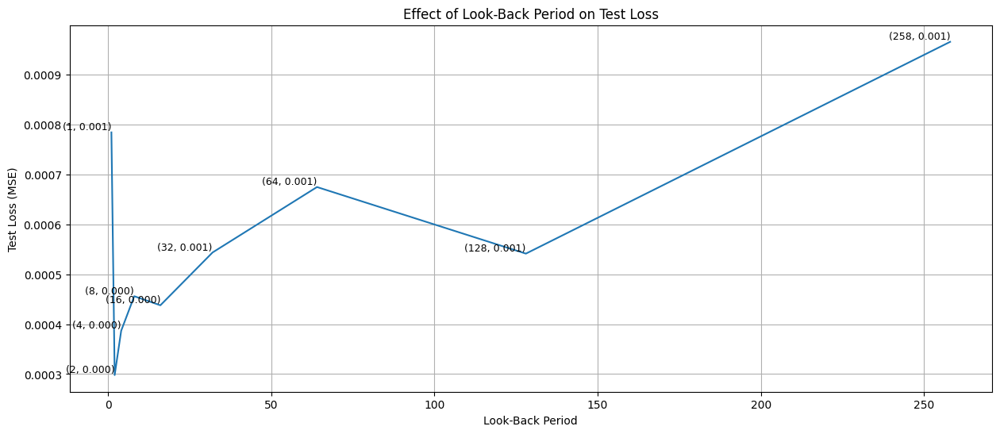

In [69]:
plot_lookback_results([2, 4, 16, 32, 64, 128])

lb value:  2


/Users/zaina/Desktop/github/financial-bot/dataprepenv/lib/python3.9/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Test Loss: 0.000302306842058897
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
lb value:  4
Test Loss: 0.0003851144283544272
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
lb value:  16
Test Loss: 0.0008786697289906442
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
lb value:  32
Test Loss: 0.0007092638406902552
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
lb value:  64
Test Loss: 0.0005079181282781065
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
lb value:  128
Test Loss: 0.0004923717933706939
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


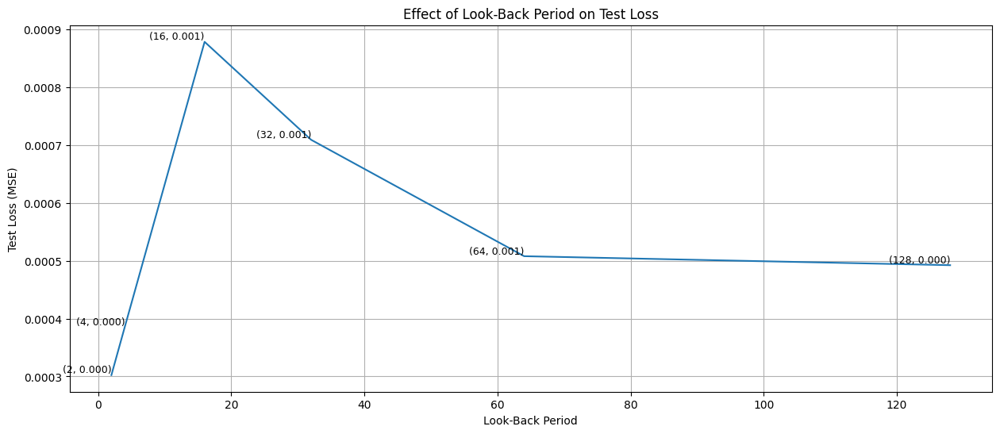

([2, 4, 16, 32, 64, 128],
 [0.000302306842058897,
  0.0003851144283544272,
  0.0008786697289906442,
  0.0007092638406902552,
  0.0005079181282781065,
  0.0004923717933706939])

In [75]:
plot_lookback_results([2, 4, 16, 32, 64, 128])